## Geog 573 (675) Advanced Geocomputing and Geospatial Big Data Analytics

### Lab 5: Geospaital Big Data Visualization
### Meiliu Wu (mwu233@wisc.edu)

### Datashader http://datashader.org/

Datashader is a graphics pipeline system for creating meaningful representations of large datasets quickly and flexibly. Datashader breaks the creation of images into a series of explicit steps that allow computations to be done on intermediate representations. This approach allows accurate and effective visualizations to be produced automatically without trial-and-error parameter tuning, and also makes it simple for data scientists to focus on particular data and relationships of interest in a principled way.

## Part One

__Question 1__: Using the US census big data visualization example at http://datashader.org/topics/census.html
to generate the population density mapping for the city of Madison, WI. Try three different histogram equalization methods: linear, log, eq_hist and briely comment on your findings. 

Each dot in this map corresponds to a specific person counted in the census, located approximately at their residence. 
(To protect privacy, the precise locations have been randomized at the census block level, 
so that the racial category can only be determined to within a rough geographic precision.)

__Load data and set up__<br>
The census data has been saved in a Parquet-format file, which can be loaded into a columnar data structure like a Pandas or Dask dataframe. This particular Parquet file was stored with the datapoints ordered to allow fast spatial queries, and we can make use of that ordering if we instantiate a SpatialPointsFrame (a type of Dask dataframe) instead of the regular Dask dataframe. See Spacial indexing for more information. To load the dataframe, you'll need to install fastparquet and python-snappy.

In [7]:
import numpy as np

In [3]:
import datashader as ds
import datashader.transfer_functions as tf

In [5]:
from datashader import spatial

In [6]:
## %%time
## downloaded from   
##     url: http://s3.amazonaws.com/datashader-data/census2010.parq.zip
##     title: '2010 Census Synthetic People'
##     files: census2010.parq
df = spatial.read_parquet('../census2010.parq')
df = df.persist()

Here we call .persist() to use Dask's fast in-core operations, but if you have less than 16GB of RAM, you can omit that line to use Dask's support for out-of-core (larger than memory) operation. Working out of core will be much slower, but should work even on small machines.

In [8]:
df.head()

,easting,northing,race
0,-12418767.0,3697425.00,h
1,-12418512.0,3697143.50,h
2,-12418245.0,3697584.50,h
3,-12417703.0,3697636.75,w
4,-12418120.0,3697129.25,h


There are 306675004 rows in this dataframe (one per person counted in the census), each with a location in Web Mercator format and a race encoded as a single character (where 'w' is white, 'b' is black, 'a' is Asian, 'h' is Hispanic, and 'o' is other (typically Native American)). (Try len(df) to see the size, if you want to check, though that always forces the dataset to be loaded so it's skipped here.)

Let's define City of Madison, WI geographic range to look at later, and also a default plot size. Feel free to increase plot_width to 2000 or more if you have a very large monitor or want to save big files to disk, which shouldn't greatly affect the processing time or memory requirements.

In [9]:
Madison = (( -89.641108,  -89.122451), (42.958087, 43.208344))

In [10]:
from datashader.utils import lnglat_to_meters as webm
x_range,y_range = [list(r) for r in webm(*Madison)]

plot_width  = int(1500)
plot_height = int(plot_width*7.0/12)

Let's also choose a background color for our results. A black background makes bright colors more vivid, and works well when later adding relatively dark satellite image backgrounds, but white backgrounds (background=None) are good for examining the weakest patterns, and work well when overlaying on maps that use light colors. Try it both ways and decide for yourself!

In [11]:
background = "black"

We'll also need some utility functions and colormaps, and to make the page as big as possible:

In [12]:
from functools import partial
from datashader.utils import export_image
from datashader.colors import colormap_select, Greys9
from IPython.core.display import HTML, display

export = partial(export_image, background = background, export_path="export")
cm = partial(colormap_select, reverse=(background!="black"))

display(HTML("<style>.container { width:100% !important; }</style>"))

In [13]:
## %%time
cvs = ds.Canvas(plot_width, plot_height, *webm(*Madison))
agg = cvs.points(df, 'easting', 'northing')

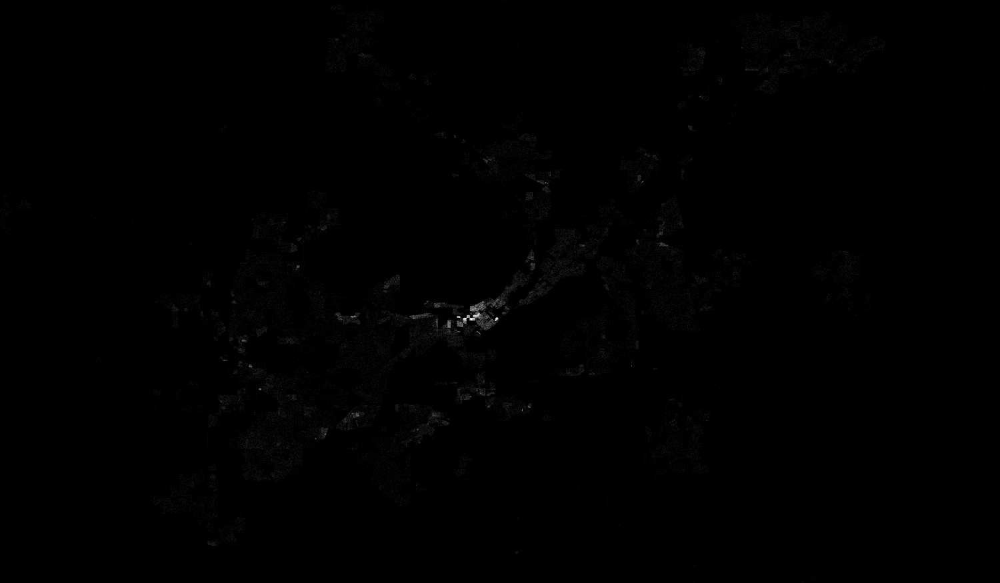

In [32]:
export(tf.shade(agg, cmap = cm(Greys9), how='linear'),"census_gray_linear")

The first thing we can do is to prevent undersampling (see plotting_pitfalls.ipynb). In the plot above, it is difficult to distinguish between pixels that are part of the background, and those that have low but nonzero counts; both are mapped to black or nearly black on a linear scale. Instead, let's map all values that are not background to a dimly visible gray, leaving the highest-density values at white. I.e., let's discard the first 25% of the gray colormap, and linearly interpolate the population densities over the remaining range:

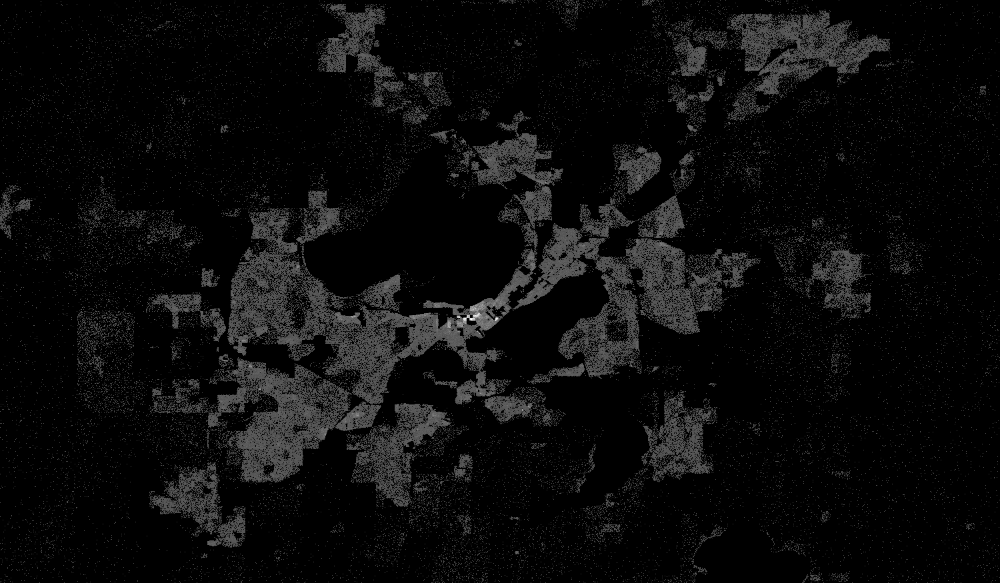

In [33]:
export(tf.shade(agg, cmap = cm(Greys9,0.25), how='linear'),"census_gray_linear")

The above plot reveals at least that data has been measured only within the political boundary of the City Of Madison, and also that most surrounding areas are so poorly populated that many pixels contained not even a single person. (In datashader images, the background color is shown for pixels that have no data at all, using the alpha channel of a PNG image, while the colormap range is shown for pixels that do have data.) Some additional population centers are now visible. But mainly what the above plot indicates is that population in the City Of Madison is extremely non-uniformly distributed, with hotspots in the center region (the east and south sides of the campus), and nearly all other pixels having lower (but nonzero) values. Population distribution pattern seems blocky.

The problem is that of the available intensity scale in this gray colormap, nearly all pixels are colored the same low-end gray value, with only the center urban areas using any other color, e.g., brighter white. Thus this version of the map conveys very little information as well. Because the data are clearly distributed so non-uniformly, let's instead try a nonlinear mapping from population counts into the colormap. A logarithmic mapping is often a good choice:

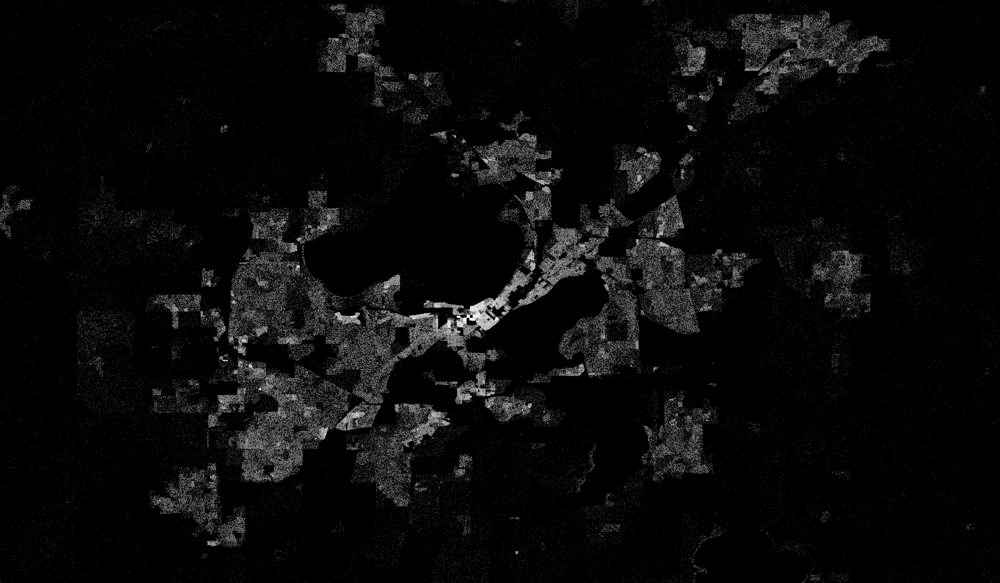

In [34]:
export(tf.shade(agg, cmap = cm(Greys9,0.2), how='log'),"census_gray_log")

Suddenly, we can see a more distinct amount of structure. There are clearly meaningful patterns at nearly every location, ranging from the geographic variations in the central areas, to the densely spaced residential areas, e.g., the surroundings of Hilldale shopping center in the west,  the isthmus between Lake Mendota and Lake Monona, etc.

Clearly, we can now see much more of what's going on in this dataset, thanks to the logarithmic mapping. Worryingly, though, the choice of 'log' was purely arbitrary, basically just a hunch based on how typical datasets behave. One could easily imagine that other nonlinear functions would show other interesting patterns, or that different functions would be needed for different datasets.

Instead of blindly searching through the space of all such functions, we can step back and notice that the main effect of the log transform has been to reveal local patterns at all population densities -- small densely populated regions show up clearly even if they are just slightly more dense than their immediate, rural neighbors, yet large center areas with high population density also show up well against the surrounding suburban regions, even if those regions are more dense than the small but densely populated regions on an absolute scale.

With this idea of showing relative differences across a large range of data values in mind, let's try the image-processing technique called histogram equalization. I.e., given a set of raw counts, map these into a range for display such that every available color on the screen represents about the same number of samples in the original dataset. The result is similar to that from the log transform, but is now non-parametric -- it will equalize any linearly or nonlinearly distributed integer data, regardless of the distribution:

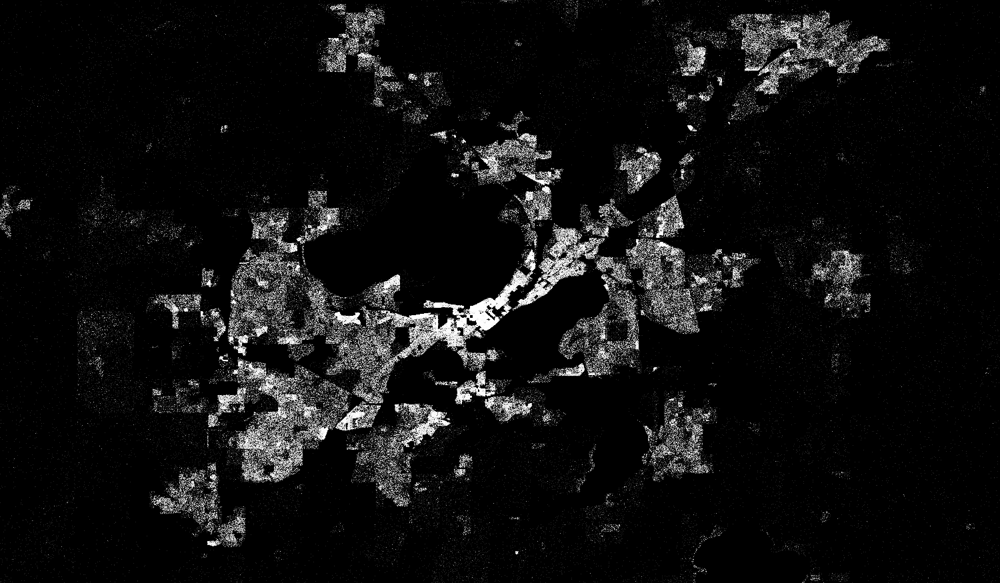

In [35]:
export(tf.shade(agg, cmap = cm(Greys9,0.2), how='eq_hist'),"census_gray_eq_hist")

(Histogram equalization also works for non-integer data, but in that case it will use a finite set of bins to divide the interval between the minimum and maximum values, and will thus not be able to normalize the histogram perfectly for highly non-uniform distributions.) Effectively, this transformation converts the data from raw magnitudes, which can easily span a much greater range than the dynamic range visible to the eye, to a rank-order or percentile representation, which reveals density differences at all ranges but obscures the absolute magnitudes that were used to compute the ordering. In this representation, you can clearly see the effects of geography (roads, lakes, and parks) on the population density, and even infrastructure (with many small populated residential areas located at main roads, shopping stores, schools, etc.).

Given the very different results from the different types of plot, a good practice when visualizing any dataset with datashader is to look at both the linear and the histogram-equalized versions of the data; the linear version preserves the magnitudes, but obscures the distribution, while the histogram-equalized version reveals the distribution while preserving only the order of the magnitudes, not their actual values. If both plots are similar, then the data is distributed nearly uniformly across the interval. But much more commonly, the distribution will be highly nonlinear, and the linear plot will reveal only the envelope of the data, i.e., the lowest and the highest values. In such cases, the histogram-equalized plot will reveal much more of the structure of the data, because it maps the local patterns in the data into perceptible color differences on the screen.

Because we are only plotting a single dimension, we can use the colors of the display to effectively reach a higher dynamic range, mapping ranges of data values into different color ranges. When doing so, it is crucial to use a perceptually uniform colormap (see this paper for more details). Here we'll use the "viridis" colormap from the datashader package:

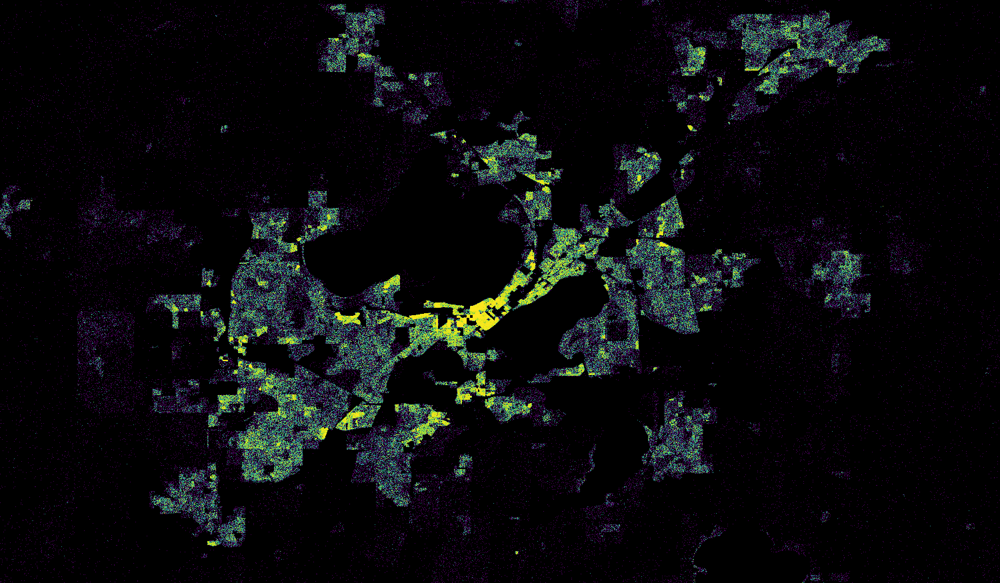

In [36]:
from datashader.colors import viridis
export(tf.shade(agg, cmap=cm(viridis), how='eq_hist'),"census_viridis_eq_hist")

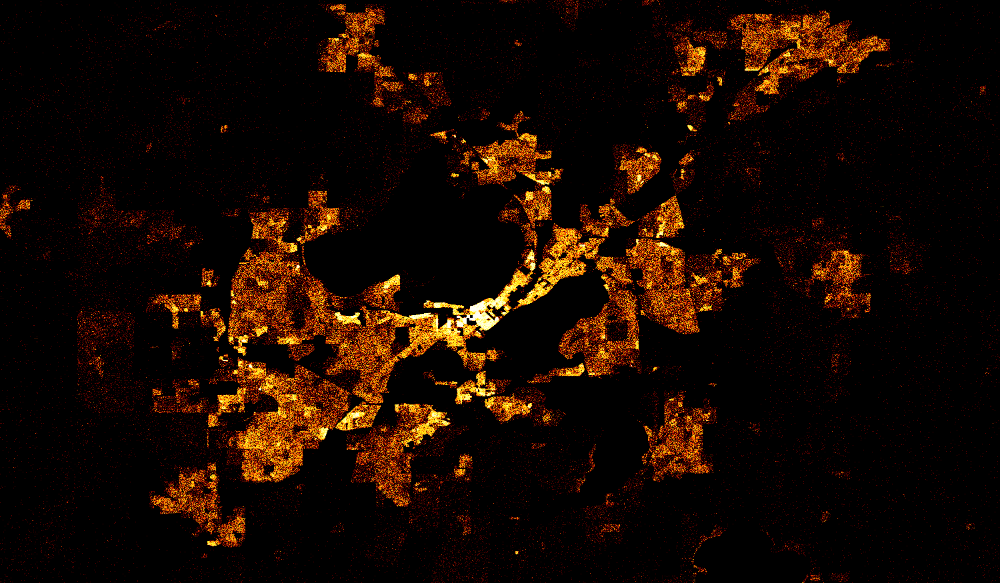

In [14]:
# Here we'll use the "fire" colormap from the colorcet package:
from colorcet import fire
export(tf.shade(agg, cmap = cm(fire,0.2), how='eq_hist'),"census_ds_fire_eq_hist")

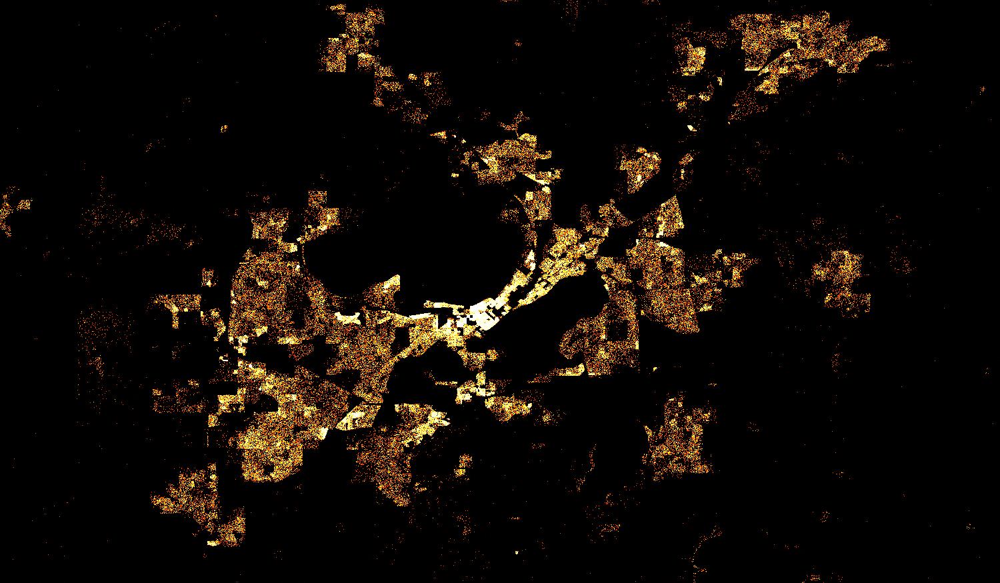

In [16]:
# Here we'll use the "hot" colormap from the matplotlib package:
from matplotlib.cm import hot
export(tf.shade(agg, cmap = hot, how='eq_hist'),"census_ds_mhot_eq_hist")

## Part Two

Question 2: Generate the race & ethnicity mapping for the state of Wisconsin. 

In [17]:
Wisconsin = (( -96.007666,  -83.803007), (41.436670, 47.698216))

Since we've got the racial category for every pixel, we can use color to indicate the category value, instead of just extending dynamic range or highlighting percentiles as above. To do this, we first need to set up a color key for each category label, with different color keys as appropriate to make colors that stand out against the background:

In [18]:
if background == "black":
      color_key = {'w':'aqua', 'b':'lime',  'a':'red', 'h':'fuchsia', 'o':'yellow' }
else: color_key = {'w':'blue', 'b':'green', 'a':'red', 'h':'orange',  'o':'saddlebrown'}

We can now aggregate the counts per race into grids, using ds.count_cat, instead of just a single grid with the total counts (via the default aggregate reducer ds.count), and then generate an image by colorizing each pixel using the aggregate information from each category for that pixel's location:

In [19]:
def create_image(longitude_range, latitude_range, w=plot_width, h=plot_height):
    x_range,y_range=webm(longitude_range,latitude_range)
    cvs = ds.Canvas(plot_width=w, plot_height=h, x_range=x_range, y_range=y_range)
    agg = cvs.points(df, 'easting', 'northing', ds.count_cat('race'))
    img = tf.shade(agg, color_key=color_key, how='eq_hist')
    return img

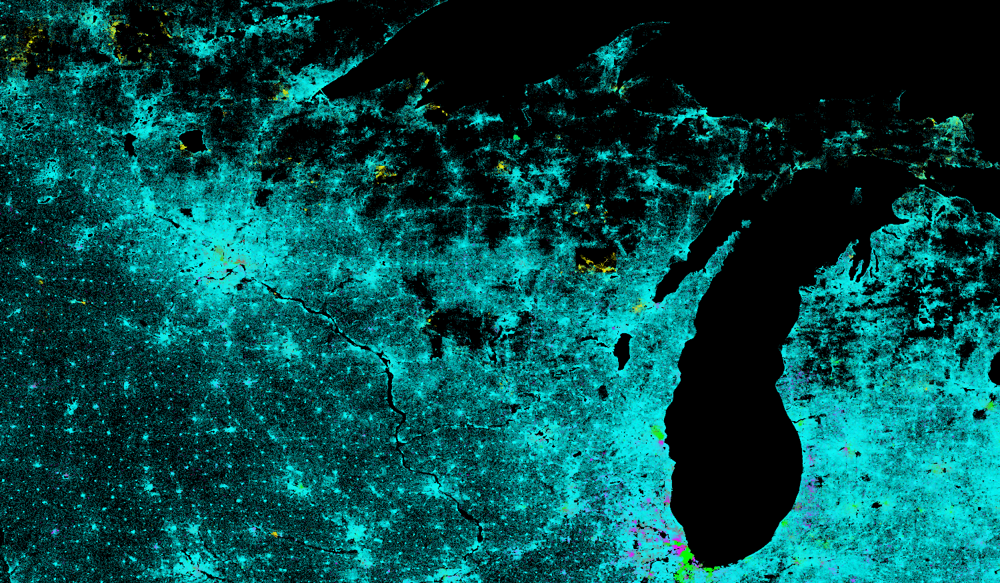

In [41]:
export(create_image(*Wisconsin),"Wisconsin")

From the above image, we can see Wisconsin state consists of mostly white race, with some sparsely-distributed Native American areas in the north, as well as a small dense black race area in the north of Milwaukee and a small dense hispanic race area in the center of Milwaukee.

## Additional work (not for grading)

In [39]:
# For comparisons: 
USA           = ((-124.72,  -66.95), (23.55, 50.06))
LakeMichigan  = (( -91.68,  -83.97), (40.75, 44.08))
Chicago       = (( -88.29,  -87.30), (41.57, 42.00))
Chinatown     = (( -87.67,  -87.63), (41.84, 41.86))
NewYorkCity   = (( -74.39,  -73.44), (40.51, 40.91))
LosAngeles    = ((-118.53, -117.81), (33.63, 33.96))
Houston       = (( -96.05,  -94.68), (29.45, 30.11))
Austin        = (( -97.91,  -97.52), (30.17, 30.37))
NewOrleans    = (( -90.37,  -89.89), (29.82, 30.05))
Atlanta       = (( -84.88,  -84.04), (33.45, 33.84))
SanFrancisco  = (( -123.364720, -121.311615), (37.145672, 38.219068)) #37.145672, -123.364720, 38.219068, -121.311615

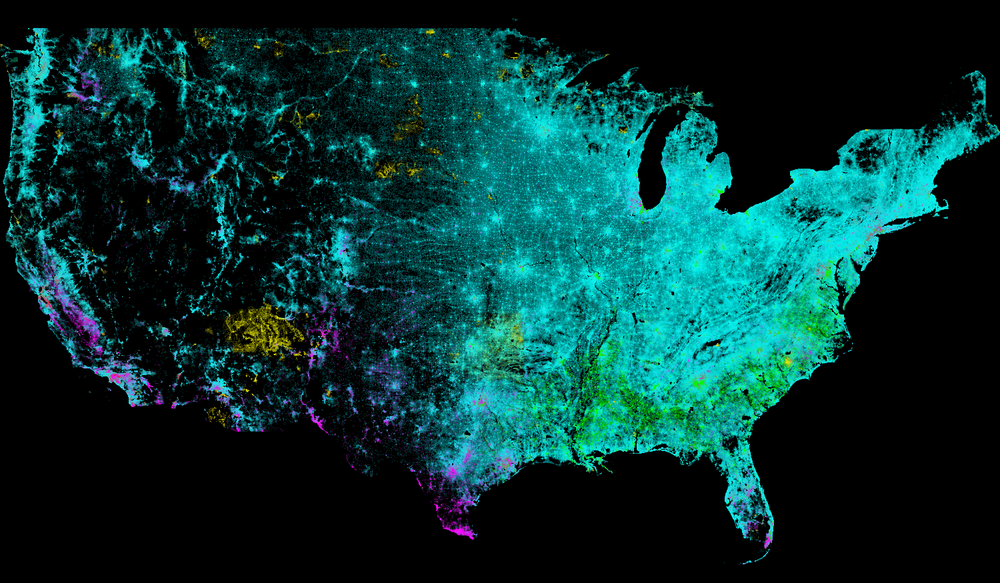

In [23]:
export(create_image(*USA),"Zoom 0 - USA")

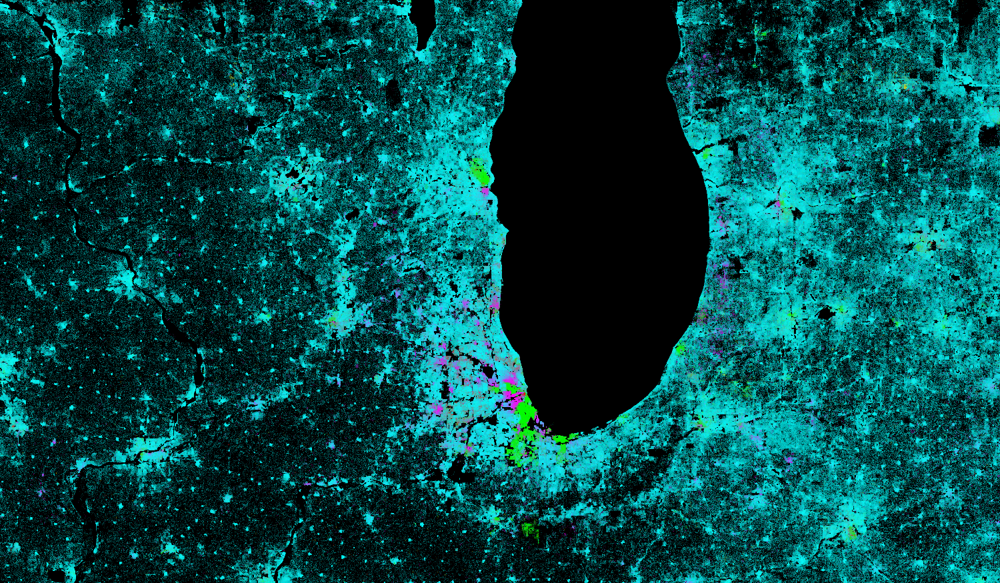

In [24]:
export(create_image(*LakeMichigan),"Zoom 1 - Lake Michigan")

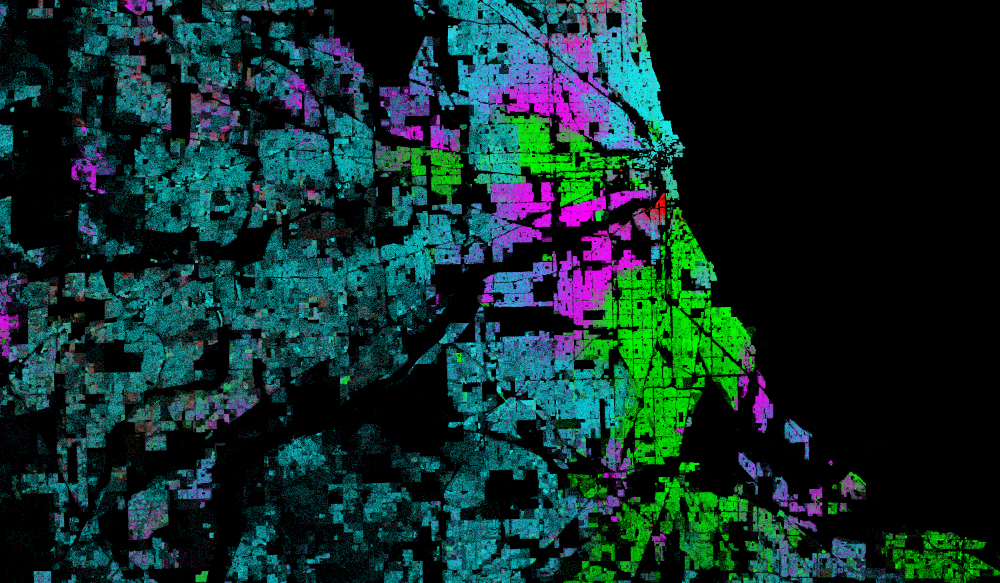

In [25]:
export(create_image(*Chicago),"Zoom 2 - Chicago")

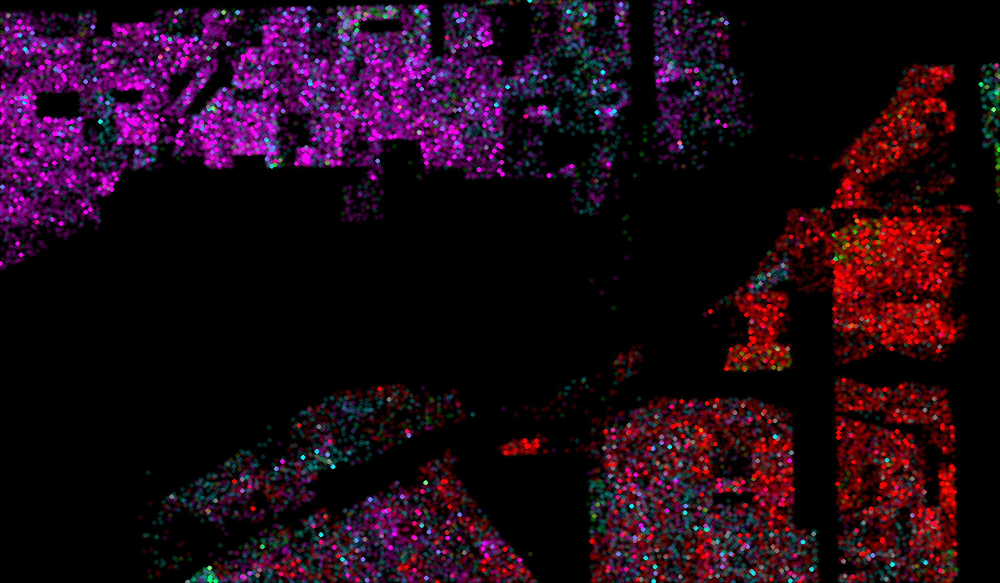

In [26]:
export(tf.spread(create_image(*Chinatown),px=plot_width//400),"Zoom 3 - Chinatown")

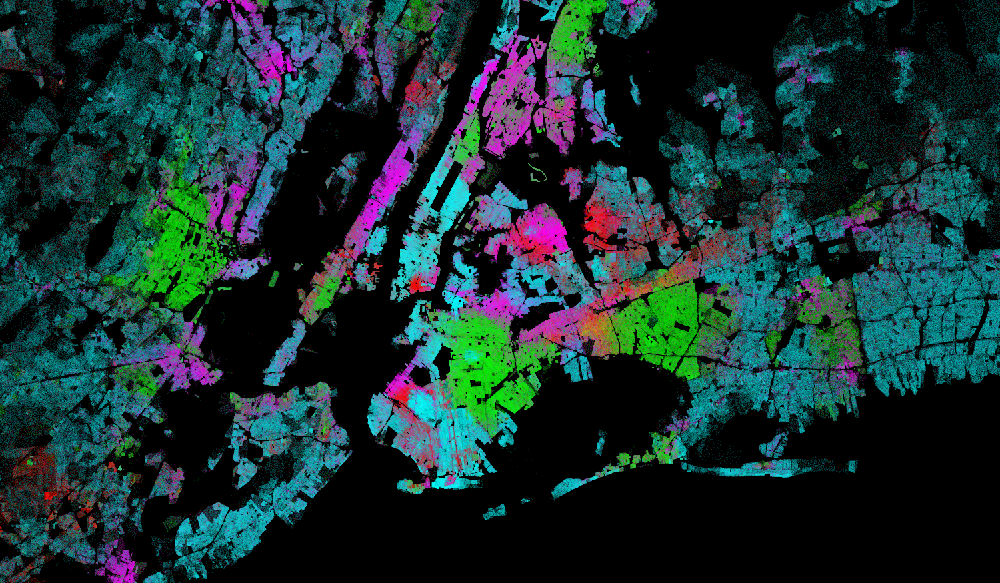

In [27]:
export(create_image(*NewYorkCity),"NYC")

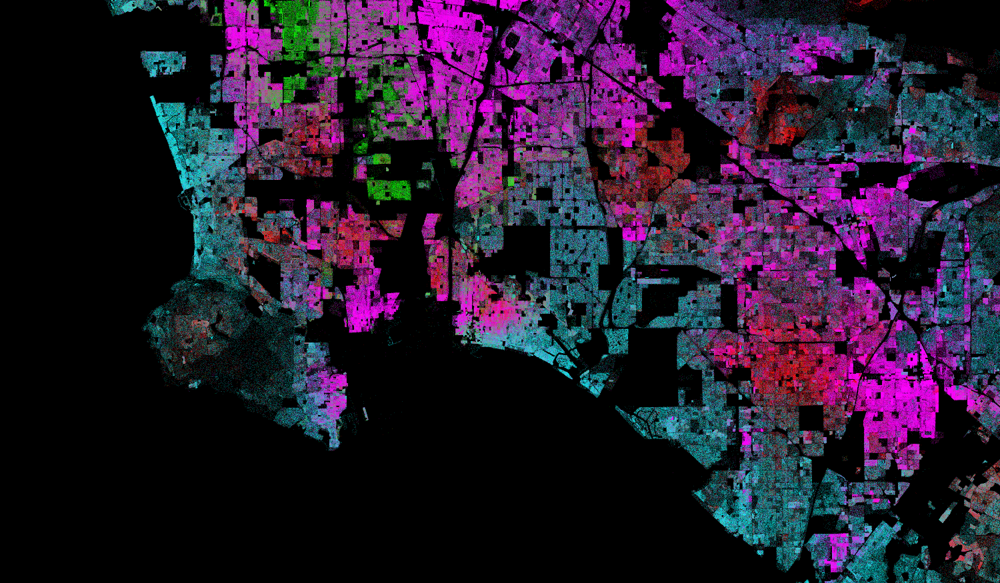

In [28]:
export(create_image(*LosAngeles),"LosAngeles")

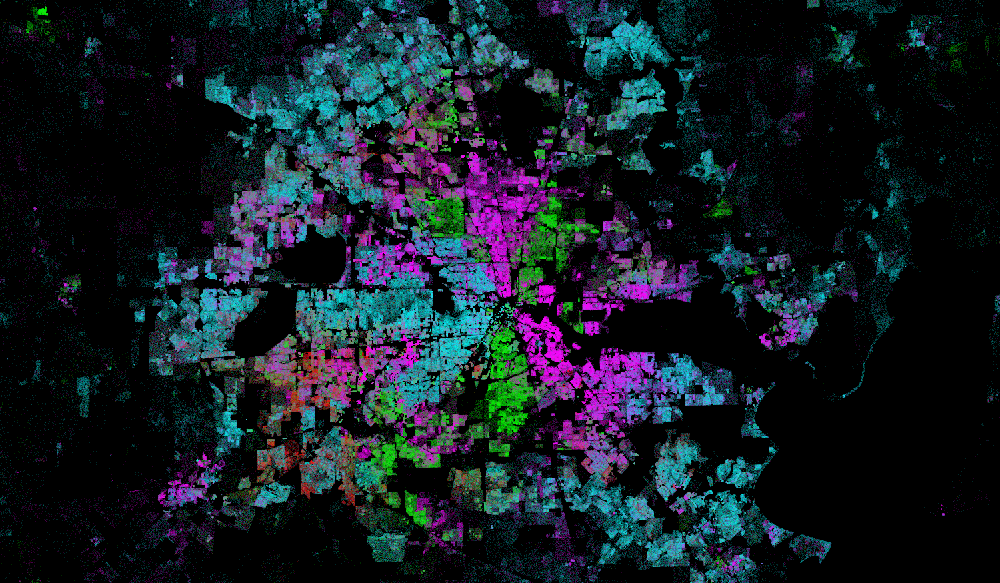

In [29]:
export(create_image(*Houston),"Houston")

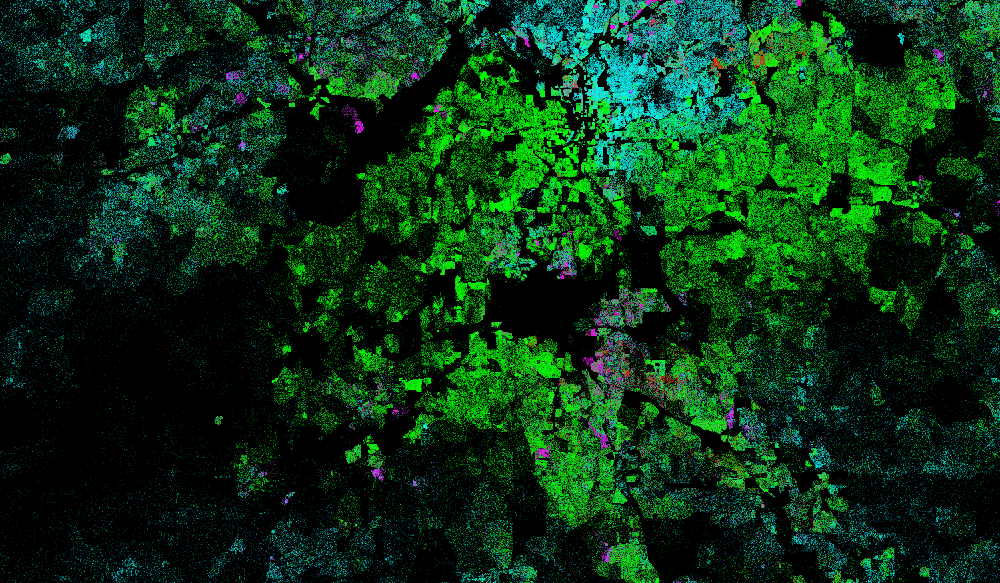

In [30]:
export(create_image(*Atlanta),"Atlanta")

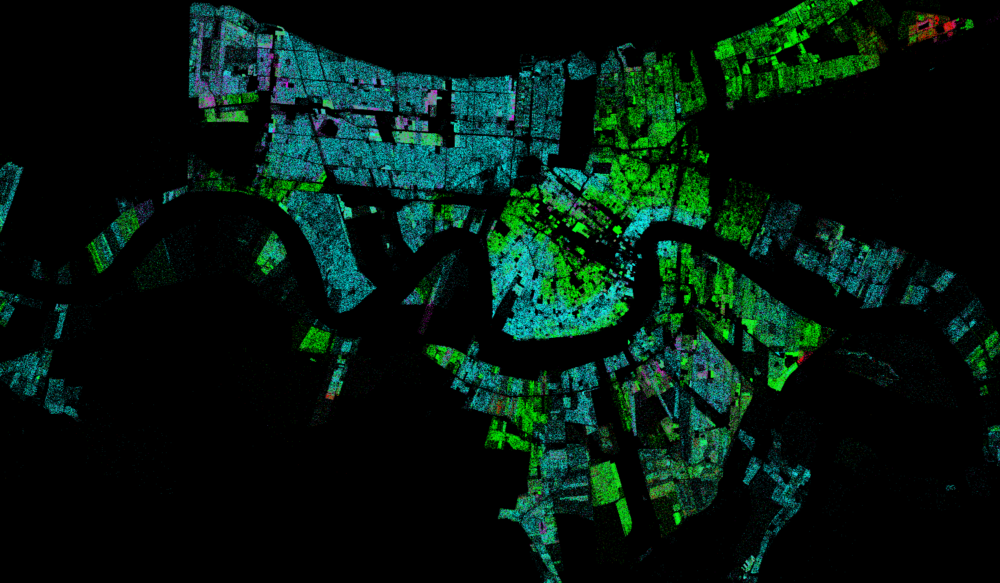

In [31]:
export(create_image(*NewOrleans),"NewOrleans")

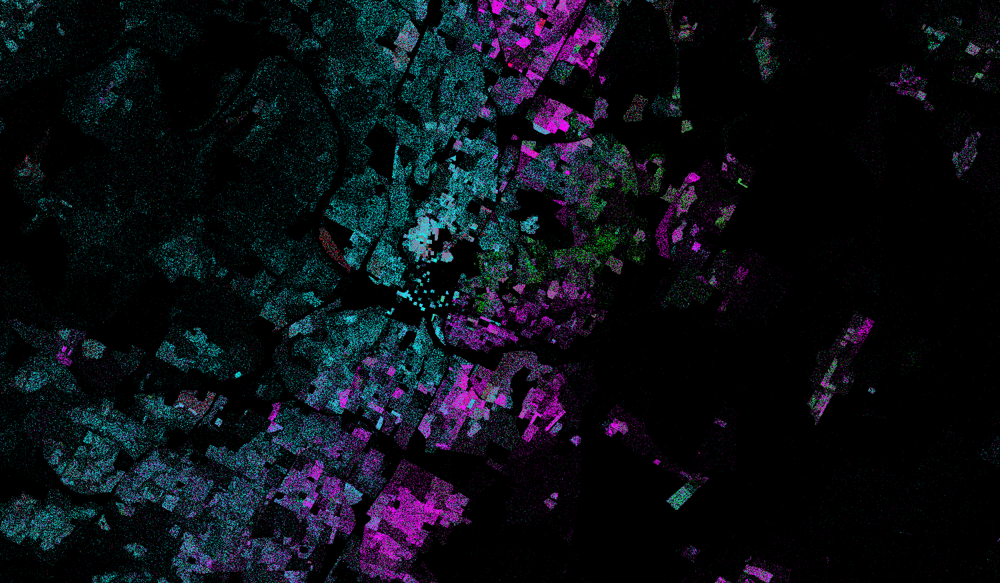

In [32]:
export(create_image(*Austin),"Austin")

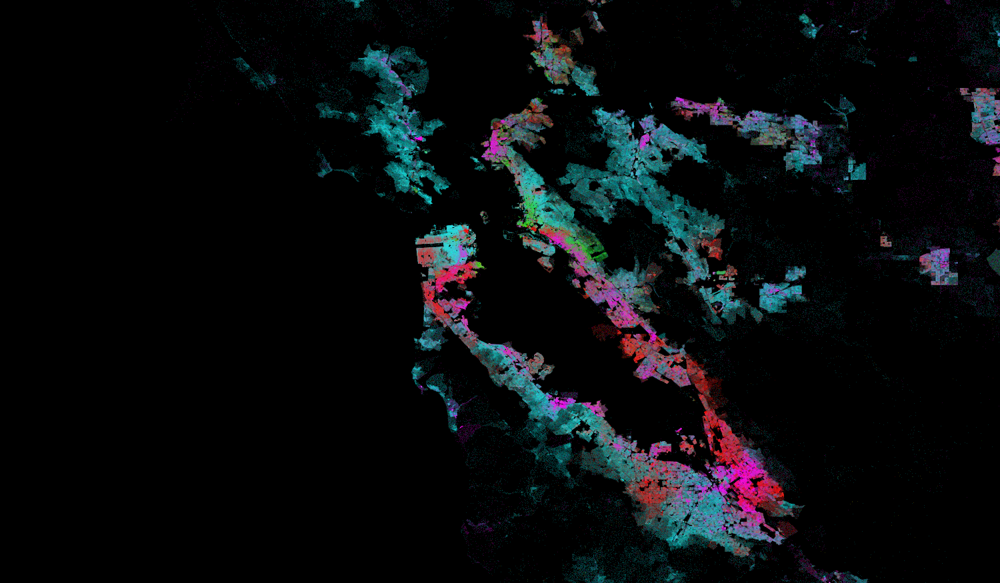

In [40]:
export(create_image(*SanFrancisco),"San Francisco")